In [1]:
%matplotlib inline
# %matplotlib qt
# Choose %matplotlib qt to plot to an interactive window (note it may show up behind your browser)
# Make some of the relevant imports
import cv2 # OpenCV for perspective transform
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import scipy.misc # For saving images as needed
import glob  # For reading in a list of images from a folder

In [2]:
path = "C:/Users/JFJ/Documents/GitHub/CarND/CarSim/simulator-windows-64/data_jfj/IMG/center_*.jpg"
img_list = glob.glob(path)
img_list_short = img_list.copy()[:1800]

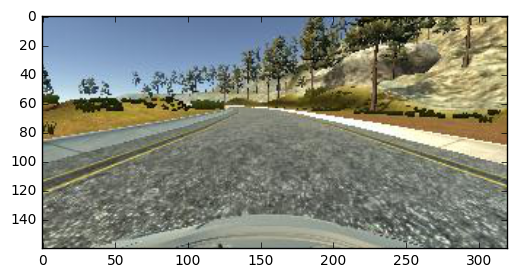

In [3]:
idx = np.random.randint(0, len(img_list)-1)
image = mpimg.imread(img_list[idx])
plt.imshow(image)

[[  9.99999817e-01  -6.04424736e-04  -6.46124112e-06]
 [  6.04424181e-04   9.99999814e-01  -8.56878776e-05]
 [  6.51303179e-06   8.56839566e-05   9.99999996e-01]]
[[ 0.93755575]
 [ 0.34778972]
 [ 0.00561419]]


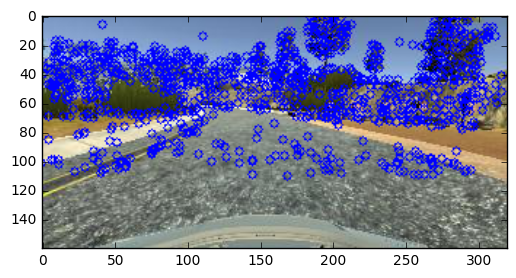

In [4]:
lk_params = dict(winSize  = (5, 5), #winSize  = (21, 21), 
				#maxLevel = 3,
                 criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 30, 0.01))

def featureTracking(image_ref, image_cur, px_ref):
    kp2, st, err = cv2.calcOpticalFlowPyrLK(image_ref, image_cur, px_ref, None, **lk_params)  #shape: [k,2] [k,1] [k,1]
    st = st.reshape(st.shape[0])
    kp1 = px_ref[st == 1]
    kp2 = kp2[st == 1]
    return kp1, kp2

ix = 100
curr_img = mpimg.imread(img_list[ix])
next_img = mpimg.imread(img_list[ix+1])

detector = cv2.FastFeatureDetector_create(threshold=25, nonmaxSuppression=True)
px_ref = detector.detect(curr_img)
px_ref = np.array([x.pt for x in px_ref], dtype=np.float32)

# print(px_ref)

px_ref, px_cur = featureTracking(curr_img[:110,:], next_img[:110,:], px_ref)
for px in px_cur:
    cv2.circle(next_img,(px[0],px[1]), 3, (0,0,255), 1)


E, mask = cv2.findEssentialMat(px_cur, px_ref, method=cv2.RANSAC, prob=0.999, threshold=1.0)
_, cur_R, cur_t, mask = cv2.recoverPose(E, px_cur, px_ref)

print(cur_R)
print(cur_t)
    
plt.imshow(next_img)

In [5]:
# Testing the code from: https://github.com/uoip/monoVO-python/blob/master/visual_odometry.py
# based on https://avisingh599.github.io/vision/monocular-vo/

class VO:
    def __init__(self):
        self.cur_R = None
        self.cur_t = None
        self.px_ref = None
        self.px_cur = None
        self.frame_stage = 0
        self.new_frame = None
        self.last_frame = None
        self.frame_id = -1
        self.kMinFeat = 1500
        self.detector = cv2.FastFeatureDetector_create(threshold=25, nonmaxSuppression=True)
        self.tracked_image = None
        self.focal = 160 # found through trial-and-error...
        self.pp = (160,80) # middle of camera image...
        
    def update(self, img):
        self.new_frame =  img
        if (self.frame_stage == 2):
            self.processFrame()
        elif (self.frame_stage == 1):
            self.processSecondFrame()
        elif (self.frame_stage == 0):
            self.processFirstFrame()
        self.last_frame = self.new_frame
        
    def processFrame(self):
        self.px_ref, self.px_cur = featureTracking(self.last_frame, self.new_frame, self.px_ref)
        E, _ = cv2.findEssentialMat(self.px_cur, self.px_ref, method=cv2.RANSAC, focal=self.focal, pp=self.pp, prob=0.999, threshold=1.0)
        _, R, t, _ = cv2.recoverPose(E, self.px_cur, self.px_ref, focal=self.focal, pp=self.pp)
        
        self.cur_t = self.cur_t + self.cur_R.dot(t)
        self.cur_R = R.dot(self.cur_R)
        
        if(self.px_ref.shape[0] < self.kMinFeat):
            self.px_cur = self.detector.detect(self.new_frame)
            self.px_cur = np.array([x.pt for x in self.px_cur], dtype=np.float32)
        
        self.px_ref = self.px_cur
    
    def processSecondFrame(self):
        self.px_ref, self.px_cur = featureTracking(self.last_frame, self.new_frame, self.px_ref)
        E, _ = cv2.findEssentialMat(self.px_cur, self.px_ref, method=cv2.RANSAC, focal=self.focal, pp=self.pp, prob=0.999, threshold=1.0)
        _, self.cur_R, self.cur_t, _ = cv2.recoverPose(E, self.px_cur, self.px_ref, focal=self.focal, pp=self.pp)
        self.frame_stage = 2
        self.px_ref = self.px_cur
    
    def processFirstFrame(self):
        
        self.px_ref = self.detector.detect(self.new_frame)
        self.px_ref = np.array([x.pt for x in self.px_ref], dtype=np.float32)
        self.frame_stage = 1
        
    def process_image(self,img):
        text= ""
        self.frame_id += 1
        self.update(img[:110,:]) #limit the image vertically - cut off the lower part
        
        processed_image = img.copy()
        
        if (self.frame_id == 0):
            self.tracked_image = np.zeros((img.shape[0]*2,img.shape[1]*1,3))
        
        
        if (self.frame_id > 1):
            for px in self.px_cur:
                cv2.circle(processed_image,(px[0],px[1]), 3, (0,0,255), 1)
                
        output_image = np.zeros((img.shape[0]*2,img.shape[1]*2,3))
        output_image[0:img.shape[0], 0:img.shape[1]] = processed_image
                
        if (self.frame_id > 2):
            
            scale = 0.75
            x, y, z = self.cur_t[0]*scale, self.cur_t[1]*scale, self.cur_t[2]*scale
            text = "Coord: " + str(x) + ", " + str(z)
            cv2.putText(output_image, text, (20, 200), cv2.FONT_HERSHEY_COMPLEX, 0.4, (255, 255, 255), 1)
            cv2.circle(self.tracked_image,(250+x, 130-z), 1, (255,255,255), 1)
        tr_img = self.tracked_image
        output_image[0:tr_img.shape[0], img.shape[1]:] = self.tracked_image
                

        return output_image
        

In [6]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from moviepy.editor import ImageSequenceClip

vo = VO()

# Define pathname to save the output video
output = 'test_mapping.mp4'

clip = ImageSequenceClip(img_list_short[:], fps=25) # Note: output video will be sped up because 
                                          # recording rate in simulator is fps=25
new_clip = clip.fl_image(vo.process_image) #NOTE: this function expects color images!!
%time new_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video test_mapping.mp4
[MoviePy] Writing video test_mapping.mp4


100%|██████████████████████████████████████| 1801/1801 [01:01<00:00, 29.33it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_mapping.mp4 

Wall time: 1min 1s


In [9]:
from IPython.display import HTML
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))

In [10]:
import io
import base64
video = io.open(output, 'r+b').read()
encoded_video = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded_video.decode('ascii')))